В этой тетрадке тестируем пайплайн для обработки одного изображения

In [1]:
import cv2
import glob
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

In [2]:
%load_ext autoreload
%autoreload 2

In [3]:
plt.rcParams['figure.figsize'] = 15, 6
import seaborn as sns
sns.set_style('white')

In [4]:
import stripes.analysis as analysis
import stripes.preprocessing as preproc
import stripes.palette as palette
from stripes.detection import Detector
from pro import pro

Часть 1 - определяем на изображении полоску и вырезаем ее:

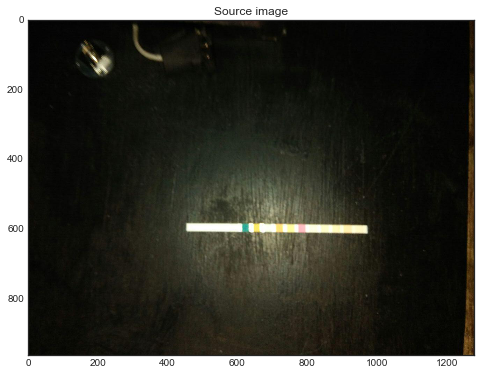

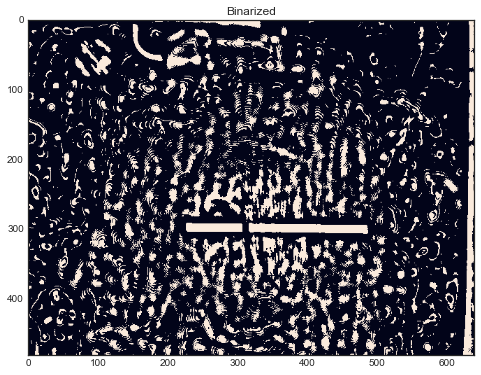

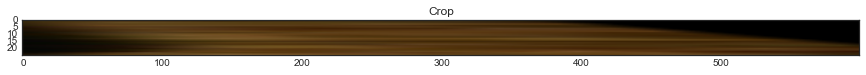

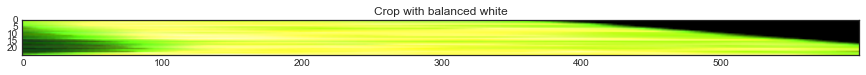

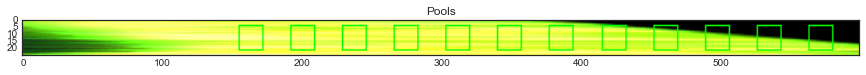

...

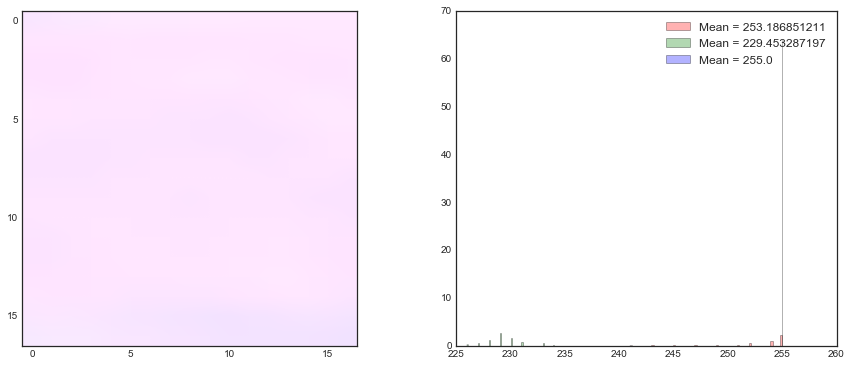

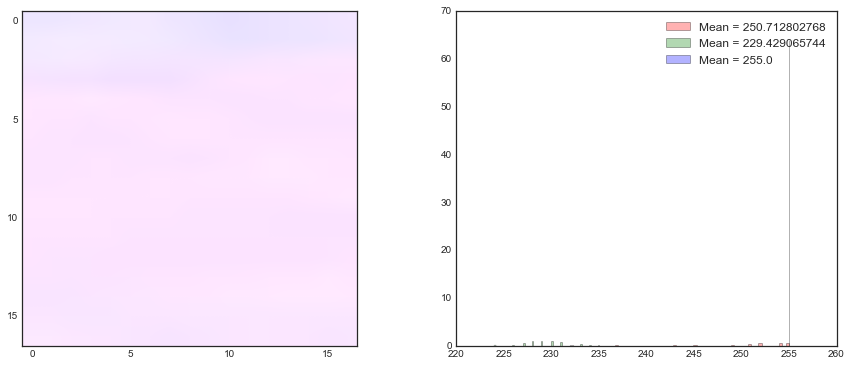

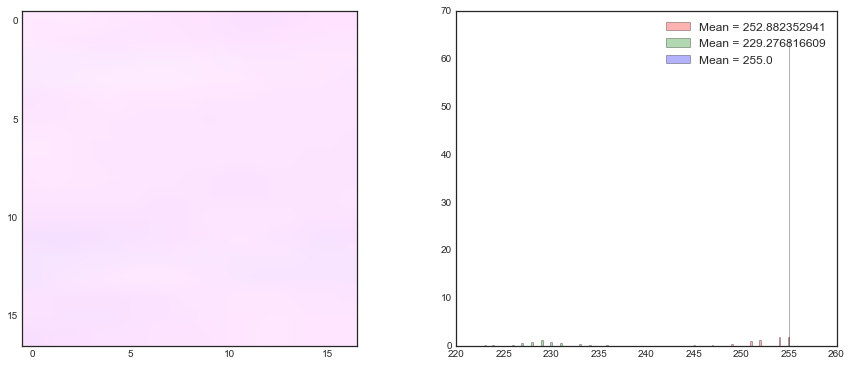

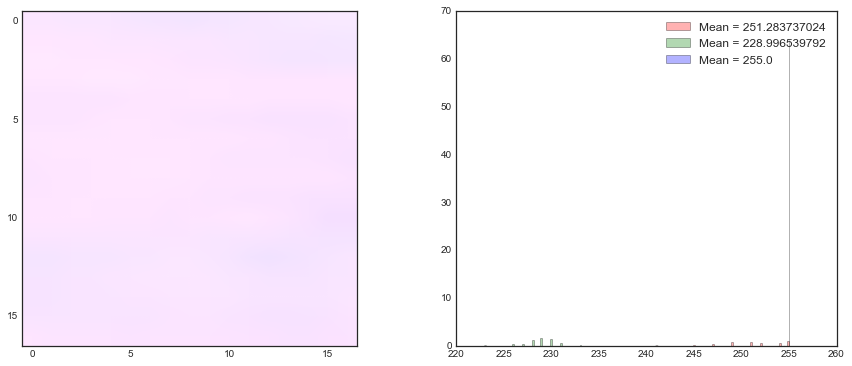

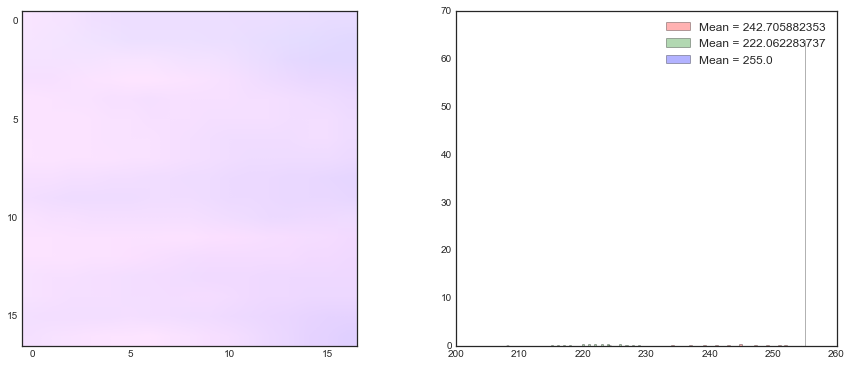

In [5]:
images_names = glob.glob("../images/large/*")
for image_name in images_names:
    
    image = cv2.cvtColor(cv2.imread(image_name), cv2.COLOR_BGR2RGB)
    plt.title("Source image")
    plt.imshow(image)
    plt.show()
    
    detector = Detector()
    crop = detector.detect(image)
    
    plt.title("Binarized")
    plt.imshow(detector.image_binary)
    plt.show()
    
    plt.title("Crop")
    plt.imshow(detector.image_warped)
    plt.show()
    
    crop_wb = preproc.adjust_white_balance(detector.image_warped)
    plt.title("Crop with balanced white")
    plt.imshow(crop_wb)
    plt.show()
        
    pool_boxes = preproc.get_pool_boxes(crop_wb)
    crop_pools = crop_wb.copy()
    for pool_box in pool_boxes:
        cv2.rectangle(crop_pools, (pool_box[0], pool_box[1]), (pool_box[2], pool_box[3]), (0, 255, 0), 1)
    plt.title("Pools")
    plt.imshow(crop_pools)
    plt.show()
    for pool_box in pool_boxes:
        pool = crop_wb[pool_box[1]: pool_box[3], pool_box[0]: pool_box[2], :]
        red = pool[:, :, 0]
        green = pool[:, :, 1]
        blue = pool[:, :, 2]
    
        plt.subplot(1, 2, 1)
        plt.imshow(pool)
        plt.subplot(1, 2, 2)
        plt.hist(red.ravel(), bins=256 / 4, normed=True, color='r', alpha=0.3, label="Mean = {}".format(red.mean()))
        plt.hist(green.ravel(), bins=256 / 4, normed=True, color='g', alpha=0.3, label="Mean = {}".format(green.mean()))
        plt.hist(blue.ravel(), bins=256 / 4, normed=True, color='b', alpha=0.3, label="Mean = {}".format(blue.mean()))
        plt.legend()
        plt.show()

Часть 3 - Считываем информацию о цветах в ячейках: